# PyAnime

## Install libraries

In [ ]:
!pip install -U gif
!pip install "gif[altair]"     
!pip install "gif[matplotlib]"
!pip install "gif[plotly]"

In [ ]:
# !pip install selenium
# !apt-get update # to update ubuntu to correctly run apt install
# !apt install chromium-chromedriver
# !cp /usr/lib/chromium-browser/chromedriver /usr/bin
# import sys
# sys.path.insert(0,'/usr/lib/chromium-browser/chromedriver')
# from selenium import webdriver
# chrome_options = webdriver.ChromeOptions()
# chrome_options.add_argument('--headless')
# chrome_options.add_argument('--no-sandbox')
# chrome_options.add_argument('--disable-dev-shm-usage')
# wd = webdriver.Chrome('chromedriver', options=chrome_options)

## General Plots

### Matplotlib

In [ ]:
import random
from matplotlib import pyplot as plt
import gif

x = [random.randint(0, 100) for _ in range(100)]
y = [random.randint(0, 100) for _ in range(100)]

gif.options.matplotlib["dpi"] = 300

@gif.frame
def plot(i):
    xi = x[i*10:(i+1)*10]
    yi = y[i*10:(i+1)*10]
    plt.scatter(xi, yi)
    plt.xlim((0, 100))
    plt.ylim((0, 100))

frames = []
for i in range(10):
    frame = plot(i)
    frames.append(frame)

gif.save(frames, 'example.gif', duration=3.5, unit="s", between="startend")

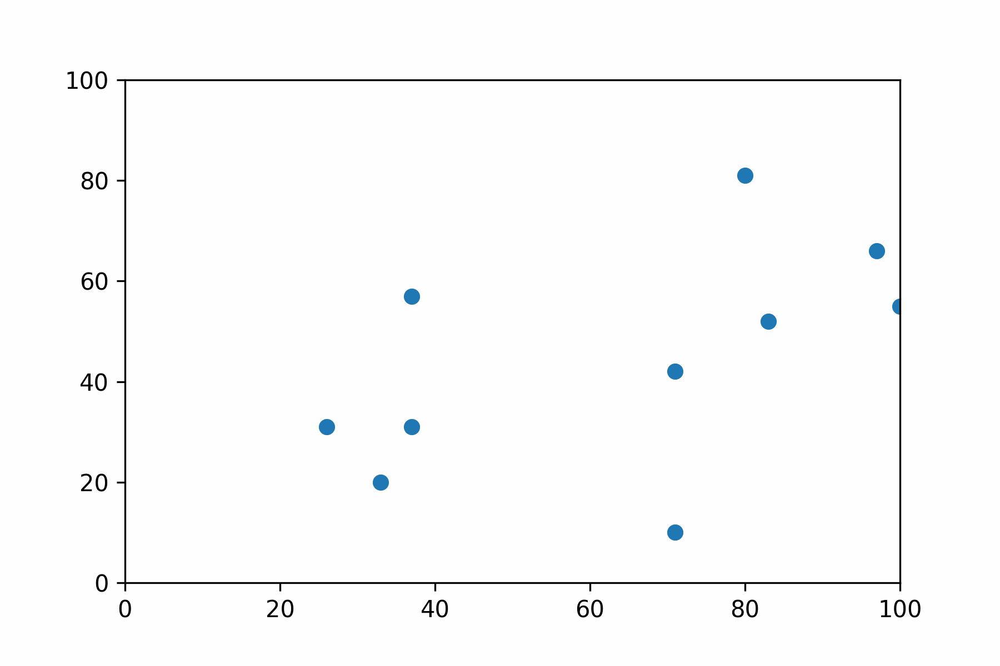

In [ ]:
from IPython.display import Image
Image(open('example.gif','rb').read(), width = 400, height = 300)

### Altair

In [ ]:
import random
import altair as alt
import pandas as pd
import gif

df = pd.DataFrame({
    't': list(range(10)) * 10,
    'x': [random.randint(0, 100) for _ in range(100)],
    'y': [random.randint(0, 100) for _ in range(100)]
})

@gif.frame
def plot(i):
    d = df[df['t'] == i]
    chart = alt.Chart(d).encode(
        x=alt.X('x', scale=alt.Scale(domain=(0, 100))),
        y=alt.Y('y', scale=alt.Scale(domain=(0, 100)))
    ).mark_circle()
    return chart

frames = []
for i in range(10):
    frame = plot(i)
    frames.append(frame)

gif.save(frames, 'example2.gif', duration=100, unit="ms", between="frames")

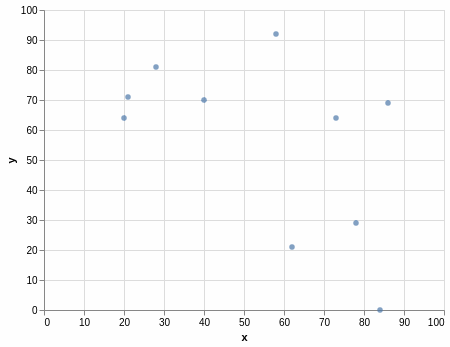

In [ ]:
from IPython.display import Image
Image(open('example2.gif','rb').read(), width = 400, height = 300)

### Plotly

In [ ]:
import random
import plotly.graph_objects as go
import pandas as pd
import gif

df = pd.DataFrame({
    't': list(range(10)) * 10,
    'x': [random.randint(0, 100) for _ in range(100)],
    'y': [random.randint(0, 100) for _ in range(100)]
})

@gif.frame
def plot(i):
    d = df[df['t'] == i]
    fig = go.Figure()
    fig.add_trace(go.Scatter(
        x=d["x"],
        y=d["y"],
        mode="markers"
    ))
    fig.update_layout(width=500, height=300)
    return fig

frames = []
for i in range(10):
    frame = plot(i)
    frames.append(frame)

gif.save(frames, 'example3.gif', duration=100)

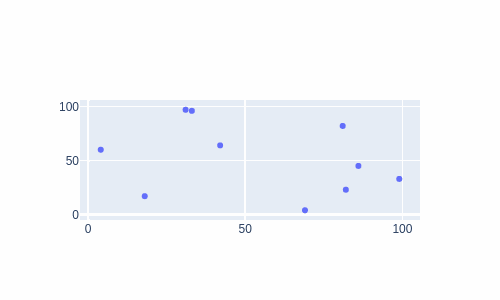

In [ ]:
from IPython.display import Image
Image(open('example3.gif','rb').read(), width = 400, height = 300)

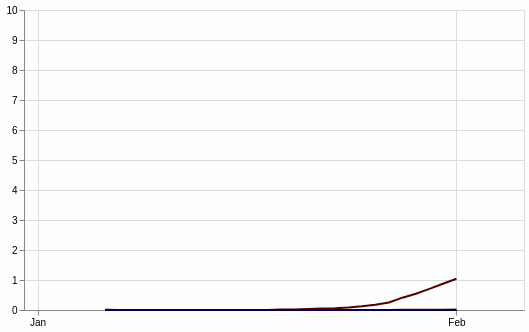

In [ ]:
import altair as alt
from altair import Chart, X, Y, Color, Scale, Axis
import pandas as pd

import gif

df = pd.read_csv('https://covid.ourworldindata.org/data/ecdc/full_data.csv')
df['date'] = pd.to_datetime(df['date'])

select = df[df['location'].isin([
    'United States',
    'China',
    'Canada',
    'Sweden']
)].reset_index(drop=True)

population = {
    'United States': 330_000_000,
    'China': 1_440_000_000,
    'Canada': 37_000_000,
    'Sweden': 10_000_100
}

select['population'] = select['location'].map(population)
select['cases_per_million'] = select.apply(lambda row: row['new_cases'] / row['population'] * 1_000_000, axis=1)
select['7d'] = select.groupby('location').rolling(7)['cases_per_million'].mean().reset_index(drop=True)

@gif.frame
def plot(date):
    
    d = select[select['date'] <= date]
    xmin = d['date'].min()
    delta = (d['date'].max() - xmin).days    
    tmax = d['date'].max() + pd.Timedelta(days=max(30, delta))
    xmax = min(tmax, d['date'].max()) + pd.Timedelta(days=5)
    ymax = max(5, d['7d'].max()) + 5
    date_ticks = pd.date_range(xmin, pd.Timestamp('now'), freq='MS').tolist()
    
    chart = Chart(d).encode(
        x=X("date", 
            title=None, 
            scale=Scale(domain=(xmin, xmax)), 
            axis=Axis(format="%b", values=date_ticks)
        ),
        y=Y('7d', title=None, scale=Scale(domain=(0, ymax))),
        color=Color('location', 
            scale=Scale(
                domain=['United States', 'China', 'Canada', 'Sweden'], 
                range=["#000055", "#550000", "#881111", "#2222CC"]
            ),
            legend=None
        )
    ).mark_line().properties(width=500, height=300)
    
    return chart

dates = pd.date_range(start='2020-02-01', end=df['date'].max())
frames = []
for date in dates:
    frame = plot(date)
    frames.append(frame)

gif.save(frames, 'covid.gif', duration=75)

from IPython.display import Image
Image(open('covid.gif','rb').read(), width = 400, height = 300)

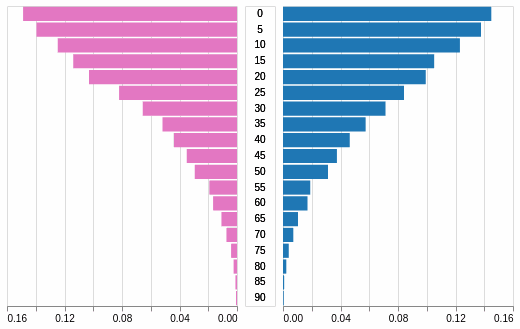

In [ ]:
import altair as alt
from vega_datasets import data
import pandas as pd
import numpy as np

import gif

source = data.population.url
df = pd.read_json(source)
df['gender'] = np.where(df['sex'] == 1, 'Male', 'Female')

pop = df.groupby(['year', 'sex'])['people'].sum().reset_index()

df = pd.merge(df, pop, on=['year', 'sex'])
df['pct'] = df['people_x'] / df['people_y']

@gif.frame
def plot(year):
    
    d = df[df['year'] == year]
    
    base = alt.Chart(d)
    color_scale = alt.Scale(domain=['Male', 'Female'], range=['#1f77b4', '#e377c2'])

    left = base.transform_filter(
        alt.datum.gender == 'Female'
    ).encode(
        y=alt.Y('age:O', axis=None),
        x=alt.X('pct',
                title=None,
                sort=alt.SortOrder('descending')),
        color=alt.Color('gender:N', scale=color_scale, legend=None)
    ).mark_bar().properties(height=300, width=230)

    middle = base.encode(
        y=alt.Y('age:O', axis=None),
        text=alt.Text('age:Q'),
        size=alt.SizeValue(10)
    ).mark_text().properties(height=300, width=30)

    right = base.transform_filter(
        alt.datum.gender == 'Male'
    ).encode(
        y=alt.Y('age:O', axis=None),
        x=alt.X('pct', title=None),
        color=alt.Color('gender:N', scale=color_scale, legend=None)
    ).mark_bar().properties(height=300, width=230)

    chart = alt.concat(left, middle, right, spacing=5)
    return chart

frames = []
for year in df.year.unique():
    frame = plot(year)
    frames.append(frame)

gif.save(frames, 'pyramid.gif', duration=500)

from IPython.display import Image
Image(open('pyramid.gif','rb').read(), width = 400, height = 300)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:57: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



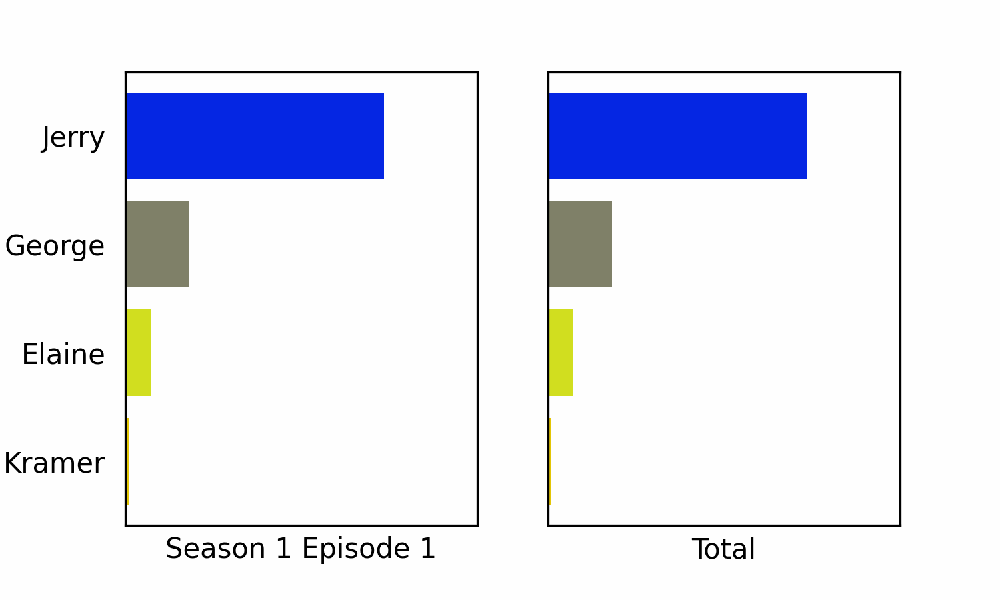

In [ ]:
import re
import pandas as pd
from matplotlib import pyplot as plt
import gif

# script cleaning
df = pd.read_csv("https://raw.githubusercontent.com/maxhumber/gif/master/gallery/matplotlib/seinfeld/seinfeld.csv")
df = df[df["character"].isin(["JERRY", "GEORGE", "ELAINE", "KRAMER"])]
df["character"] = df["character"].str.capitalize()
df["episode"] = df["episode"].apply(
    lambda x: float(f'{x.split("E")[0][1:]}.{x.split("E")[1]}')
)
df["line"] = df["line"].apply(lambda x: re.sub("(?<=\()(.*)(?=\))", "", x))
df["words"] = df["line"].apply(lambda x: len(re.findall("\w+", x)))
df = df.groupby(["episode", "character"])["words"].sum().reset_index()
df = df.sort_values(["episode", "character"])

# if character doesn't appear in episode...
df = df.set_index(["episode", "character"])
df = df.reindex(
    pd.MultiIndex.from_product(
        [df.index.levels[0], df.index.levels[1]], names=["episode", "character"]
    ),
    fill_value=0,
)
df = df.reset_index()

# calculate words in episode
wie = df.groupby(["episode"]).sum()
wie = wie.rename(columns={"words": "wie"})
wie["wie_cumsum"] = wie["wie"].cumsum()
wie = wie.reset_index()

# calculate character cumsum
df = pd.merge(df, wie, on=["episode"])
df["character_cumsum"] = df.groupby("character")["words"].cumsum()
df["%"] = df["character_cumsum"] / df["wie_cumsum"]
df["e%"] = df["words"] / df["wie"]
df = df[["episode", "character", "%", "e%"]]
df = df.sort_values(["episode", "%"])
df["episode"] = df["episode"].apply(
    lambda x: str(x) + "0" if len(str(x)) == 3 else str(x)
)

# colour mapping
COLOURS = {
    "Jerry": "#0526E3",
    "George": "#7F8068",
    "Elaine": "#D1DE1F",
    "Kramer": "#E3C505",
}


@gif.frame
def plot(episode):
    ep = df[df["episode"] == episode]
    ep["color"] = ep["character"].map(COLOURS)
    title = ep["episode"].values[0].split(".")
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(5, 3), dpi=100)
    # episode plot
    axes[0].barh(ep["character"], ep["e%"], color=ep["color"])
    axes[0].set_xlim([0, 1])
    axes[0].set_xticks([])
    axes[0].yaxis.set_tick_params(labelsize=10)
    axes[0].yaxis.set_ticks_position("none")
    axes[0].set_facecolor("#FFFFFF")
    axes[0].set_xlabel(f"Season {title[0]} Episode {int(title[1])}")
    # total plot
    axes[1].barh(ep["character"], ep["%"], color=ep["color"])
    axes[1].set_xlim([0, 1])
    axes[1].set_xticks([])
    axes[1].set_yticks([])
    axes[1].set_xlabel(f"Total")
    axes[1].set_facecolor("#FFFFFF")


frames = []
for episode in df.episode.unique():
    frame = plot(episode)
    frames.append(frame)

gif.save(frames, "seinfeld.gif", duration=100)

from IPython.display import Image
Image(open('seinfeld.gif','rb').read(), width = 400, height = 300)